## Step 1: Data Preparation

In [7]:
import pandas as pd
from datetime import datetime

# Load the data
file_path = 'customer_details_v3.csv'  # Update the path as necessary
customer_data = pd.read_csv(file_path)

# Define the current date for RFM analysis
current_date = datetime.strptime('2018-10-17', '%Y-%m-%d')

# Calculate recency (number of days since the last order)
customer_data['last_order'] = pd.to_datetime(customer_data['last_order'])
customer_data['recency'] = (current_date - customer_data['last_order']).dt.days

# Calculate frequency using the 'connection_days' column
customer_data['frequency'] = customer_data['connection_days']

# Calculate monetary value using the 'total_spent' column
customer_data['monetary'] = customer_data['total_spent']

# Select the necessary columns for RFM analysis
rfm_data = customer_data[['customer_unique_id', 'recency', 'frequency', 'monetary']]

# Ensure the columns are numeric
rfm_data['recency'] = pd.to_numeric(rfm_data['recency'], errors='coerce')
rfm_data['frequency'] = pd.to_numeric(rfm_data['frequency'], errors='coerce')
rfm_data['monetary'] = pd.to_numeric(rfm_data['monetary'], errors='coerce')

# Handle missing values by replacing them with the mean of the column
rfm_data['recency'].fillna(rfm_data['recency'].mean(), inplace=True)
rfm_data['frequency'].fillna(rfm_data['frequency'].mean(), inplace=True)
rfm_data['monetary'].fillna(rfm_data['monetary'].mean(), inplace=True)

# Convert RFM scores to numeric for clustering
rfm_data['R'] = rfm_data['recency'].astype(int)
rfm_data['F'] = rfm_data['frequency'].astype(int)
rfm_data['M'] = rfm_data['monetary'].astype(float)

# Prepare data for clustering
rfm_features = rfm_data[['R', 'F', 'M']]

/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_61724/905693552.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rfm_data['recency'] = pd.to_numeric(rfm_data['recency'], errors='coerce')
/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_61724/905693552.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rfm_data['frequency'] = pd.to_numeric(rfm_data['frequency'], errors='coerce')
/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_61724/905693552.py:27: SettingWithCopyWarning

## Step 2: K-means Clustering

In [8]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# Variables to store the results
silhouette_scores = []
wcss_values = []

# Test K-means algorithm for different k values
k_values = range(2, 10)
for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(rfm_features)
    
    cluster_labels = kmeans.labels_
    
    # Calculate silhouette score
    silhouette_avg = silhouette_score(rfm_features, cluster_labels)
    silhouette_scores.append(silhouette_avg)
    
    # Calculate WCSS (Within-Cluster Sum of Squares)
    wcss = kmeans.inertia_
    wcss_values.append(wcss)
    
# Display silhouette scores and WCSS values
silhouette_scores, wcss_values

([0.36254116993013574,
  0.43425722881943063,
  0.45618621246227914,
  0.3774221304341063,
  0.39605983745864765,
  0.40188685790641565,
  0.34580981786120907,
  0.34779496795760106],
 [5791571354.482428,
  3106308905.939846,
  2237054395.619091,
  1887048699.3384533,
  1520926521.5478172,
  1257346368.7679858,
  1165347351.1168325,
  989215329.2733686])

## Step 3: Visualization

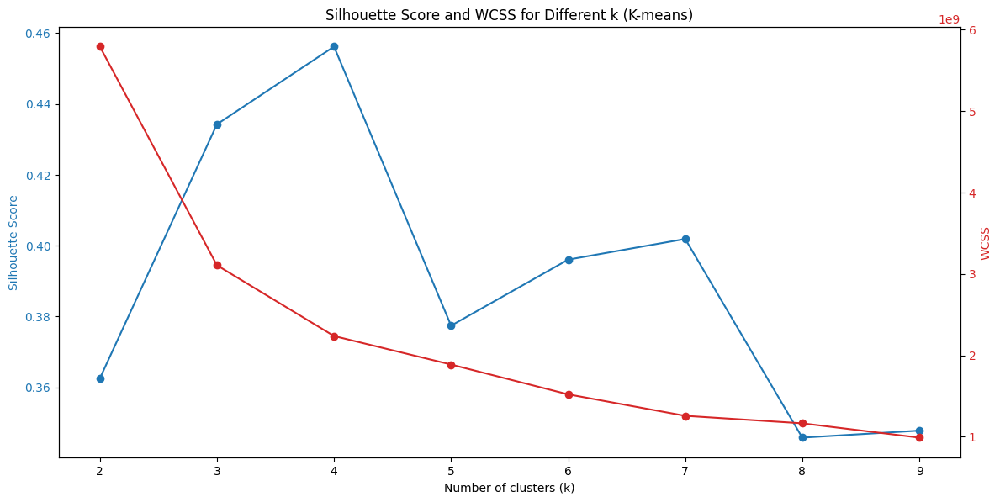

In [9]:
import matplotlib.pyplot as plt

# Plot silhouette scores and WCSS values
fig, ax1 = plt.subplots(figsize=(12, 6))

color = 'tab:blue'
ax1.set_xlabel('Number of clusters (k)')
ax1.set_ylabel('Silhouette Score', color=color)
ax1.plot(k_values, silhouette_scores, marker='o', color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
color = 'tab:red'
ax2.set_ylabel('WCSS', color=color)  # we already handled the x-label with ax1
ax2.plot(k_values, wcss_values, marker='o', color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.title('Silhouette Score and WCSS for Different k (K-means)')
plt.show()

In [12]:
import pandas as pd
from datetime import datetime
from sklearn.cluster import KMeans
import plotly.express as px

# Charger les données
file_path = 'customer_details_v3.csv'  # Remplacez par le chemin correct
customer_data = pd.read_csv(file_path)

# Définir la date actuelle pour l'analyse RFM
current_date = datetime.strptime('2018-10-17', '%Y-%m-%d')

# Calculer la récence (nombre de jours depuis la dernière commande)
customer_data['last_order'] = pd.to_datetime(customer_data['last_order'])
customer_data['recency'] = (current_date - customer_data['last_order']).dt.days

# Calculer la fréquence en utilisant la colonne 'connection_days'
customer_data['frequency'] = customer_data['connection_days']

# Calculer la valeur monétaire en utilisant la colonne 'total_spent'
customer_data['monetary'] = customer_data['total_spent']

# Sélectionner les colonnes nécessaires pour l'analyse RFM
rfm_data = customer_data[['customer_unique_id', 'recency', 'frequency', 'monetary']]

# S'assurer que les colonnes sont de type numérique
rfm_data['recency'] = pd.to_numeric(rfm_data['recency'], errors='coerce')
rfm_data['frequency'] = pd.to_numeric(rfm_data['frequency'], errors='coerce')
rfm_data['monetary'] = pd.to_numeric(rfm_data['monetary'], errors='coerce')

# Traiter les valeurs manquantes en les remplaçant par la moyenne de la colonne
rfm_data['recency'].fillna(rfm_data['recency'].mean(), inplace=True)
rfm_data['frequency'].fillna(rfm_data['frequency'].mean(), inplace=True)
rfm_data['monetary'].fillna(rfm_data['monetary'].mean(), inplace=True)

# Convertir les scores RFM en numérique pour le clustering
rfm_data['R'] = rfm_data['recency'].astype(int)
rfm_data['F'] = rfm_data['frequency'].astype(int)
rfm_data['M'] = rfm_data['monetary'].astype(float)

# Préparer les données pour le clustering
rfm_features = rfm_data[['R', 'F', 'M']]

# Choisir k=4 pour k-means
k = 4
kmeans = KMeans(n_clusters=k, random_state=42)
kmeans.fit(rfm_features)

# Ajouter les étiquettes des clusters aux données RFM
rfm_data['Cluster'] = kmeans.labels_

# Créer le plot 3D dynamique avec Plotly
fig = px.scatter_3d(rfm_data, x='R', y='F', z='M', color='Cluster', title='Clusters trouvés par K-means avec k=4')

# Afficher le plot
fig.show()

/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_61724/4119354630.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rfm_data['recency'] = pd.to_numeric(rfm_data['recency'], errors='coerce')
/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_61724/4119354630.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rfm_data['frequency'] = pd.to_numeric(rfm_data['frequency'], errors='coerce')
/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_61724/4119354630.py:29: SettingWithCopyWarn

In [13]:
import pandas as pd
from datetime import datetime
from sklearn.cluster import KMeans
import plotly.express as px

# Charger les données
file_path = 'customer_details_v3.csv'  # Remplacez par le chemin correct
customer_data = pd.read_csv(file_path)

# Définir la date actuelle pour l'analyse RFM
current_date = datetime.strptime('2018-10-17', '%Y-%m-%d')

# Calculer la récence (nombre de jours depuis la dernière commande)
customer_data['last_order'] = pd.to_datetime(customer_data['last_order'])
customer_data['recency'] = (current_date - customer_data['last_order']).dt.days

# Calculer la fréquence en utilisant la colonne 'connection_days'
customer_data['frequency'] = customer_data['connection_days']

# Calculer la valeur monétaire en utilisant la colonne 'total_spent'
customer_data['monetary'] = customer_data['total_spent']

# Sélectionner les colonnes nécessaires pour l'analyse RFM
rfm_data = customer_data[['customer_unique_id', 'recency', 'frequency', 'monetary']]

# S'assurer que les colonnes sont de type numérique
rfm_data['recency'] = pd.to_numeric(rfm_data['recency'], errors='coerce')
rfm_data['frequency'] = pd.to_numeric(rfm_data['frequency'], errors='coerce')
rfm_data['monetary'] = pd.to_numeric(rfm_data['monetary'], errors='coerce')

# Traiter les valeurs manquantes en les remplaçant par la moyenne de la colonne
rfm_data['recency'].fillna(rfm_data['recency'].mean(), inplace=True)
rfm_data['frequency'].fillna(rfm_data['frequency'].mean(), inplace=True)
rfm_data['monetary'].fillna(rfm_data['monetary'].mean(), inplace=True)

# Calculer les quantiles pour les scores RFM
quantiles = rfm_data[['recency', 'frequency', 'monetary']].quantile(q=[0.25, 0.5, 0.75]).to_dict()

# Fonction pour attribuer des scores RFM basés sur les quantiles
def r_score(x):
    if x <= quantiles['recency'][0.25]:
        return 4
    elif x <= quantiles['recency'][0.50]:
        return 3
    elif x <= quantiles['recency'][0.75]:
        return 2
    else:
        return 1

def fm_score(x, c):
    if x <= quantiles[c][0.25]:
        return 1
    elif x <= quantiles[c][0.50]:
        return 2
    elif x <= quantiles[c][0.75]:
        return 3
    else:
        return 4

rfm_data['R'] = rfm_data['recency'].apply(r_score)
rfm_data['F'] = rfm_data['frequency'].apply(fm_score, c='frequency')
rfm_data['M'] = rfm_data['monetary'].apply(fm_score, c='monetary')

# Préparer les données pour le clustering
rfm_features = rfm_data[['R', 'F', 'M']]

# Choisir k=4 pour k-means
k = 4
kmeans = KMeans(n_clusters=k, random_state=42)
kmeans.fit(rfm_features)

# Ajouter les étiquettes des clusters aux données RFM
rfm_data['Cluster'] = kmeans.labels_

# Créer le plot 3D dynamique avec Plotly
fig = px.scatter_3d(rfm_data, x='R', y='F', z='M', color='Cluster', title='Clusters trouvés par K-means avec k=4 (RFM Quantiles)')

# Afficher le plot
fig.show()

/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_61724/3787075803.py:27: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_61724/3787075803.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_61724/3787075803.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in th

In [1]:
import pandas as pd
from datetime import datetime
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
import plotly.express as px
import numpy as np

# Charger les données
file_path = 'customer_details_v3.csv'  # Remplacez par le chemin correct
customer_data = pd.read_csv(file_path)

# Définir la date actuelle pour l'analyse RFM
current_date = datetime.strptime('2018-10-17', '%Y-%m-%d')

# Calculer la récence (nombre de jours depuis la dernière commande)
customer_data['last_order'] = pd.to_datetime(customer_data['last_order'])
customer_data['recency'] = (current_date - customer_data['last_order']).dt.days

# Calculer la fréquence en utilisant la colonne 'connection_days'
customer_data['frequency'] = customer_data['connection_days']

# Calculer la valeur monétaire en utilisant la colonne 'total_spent'
customer_data['monetary'] = customer_data['total_spent']

# Sélectionner les colonnes nécessaires pour l'analyse RFM
rfm_data = customer_data[['customer_unique_id', 'recency', 'frequency', 'monetary']]

# S'assurer que les colonnes sont de type numérique
rfm_data['recency'] = pd.to_numeric(rfm_data['recency'], errors='coerce')
rfm_data['frequency'] = pd.to_numeric(rfm_data['frequency'], errors='coerce')
rfm_data['monetary'] = pd.to_numeric(rfm_data['monetary'], errors='coerce')

# Traiter les valeurs manquantes en les remplaçant par la moyenne de la colonne
rfm_data['recency'].fillna(rfm_data['recency'].mean(), inplace=True)
rfm_data['frequency'].fillna(rfm_data['frequency'].mean(), inplace=True)
rfm_data['monetary'].fillna(rfm_data['monetary'].mean(), inplace=True)

# Convertir les scores RFM en numérique pour le clustering
rfm_data['R'] = rfm_data['recency'].astype(int)
rfm_data['F'] = rfm_data['frequency'].astype(int)
rfm_data['M'] = rfm_data['monetary'].astype(float)

# Préparer les données pour le clustering
rfm_features = rfm_data[['R', 'F', 'M']]

# Choisir k=4 pour k-means
k = 4
kmeans = KMeans(n_clusters=k, random_state=42)
kmeans.fit(rfm_features)

# Ajouter les étiquettes des clusters aux données RFM
rfm_data['Cluster'] = kmeans.labels_

# Créer le plot 3D dynamique avec Plotly
fig = px.scatter_3d(rfm_data, x='R', y='F', z='M', color='Cluster', title='Clusters trouvés par K-means avec k=4')

# Afficher le plot
fig.show()

# Test de stabilité avec score ARI
n_init = 10  # Nombre d'initialisations
aris = []

# Effectuer KMeans plusieurs fois avec différentes initialisations
for _ in range(n_init):
    kmeans1 = KMeans(n_clusters=k, n_init=1, random_state=np.random.randint(10000)).fit(rfm_features)
    kmeans2 = KMeans(n_clusters=k, n_init=1, random_state=np.random.randint(10000)).fit(rfm_features)
    ari = adjusted_rand_score(kmeans1.labels_, kmeans2.labels_)
    aris.append(ari)

# Afficher les résultats
print(f'Scores ARI pour {n_init} initialisations : {aris}')
print(f'Score ARI moyen : {np.mean(aris)}')

/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_96850/662843303.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rfm_data['recency'] = pd.to_numeric(rfm_data['recency'], errors='coerce')
/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_96850/662843303.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rfm_data['frequency'] = pd.to_numeric(rfm_data['frequency'], errors='coerce')
/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_96850/662843303.py:31: SettingWithCopyWarning

Scores ARI pour 10 initialisations : [0.36198384883613677, 0.9688742520504331, 0.3749539186193325, 0.9849800346391799, 0.9904691424633487, 0.978130437096212, 0.999935643101871, 0.99052537789863, 0.35876991690977184, 0.9785534677152089]
Score ARI moyen : 0.7987176039330125


In [3]:
import pandas as pd
from datetime import datetime
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
import plotly.express as px
import numpy as np

# Charger les données
file_path = 'customer_details_v3.csv'  # Remplacez par le chemin correct
customer_data = pd.read_csv(file_path)

# Définir la date actuelle pour l'analyse RFM
current_date = datetime.strptime('2018-10-17', '%Y-%m-%d')

# Calculer la récence (nombre de jours depuis la dernière commande)
customer_data['last_order'] = pd.to_datetime(customer_data['last_order'])
customer_data['recency'] = (current_date - customer_data['last_order']).dt.days

# Calculer la fréquence en utilisant la colonne 'connection_days'
customer_data['frequency'] = customer_data['connection_days']

# Calculer la valeur monétaire en utilisant la colonne 'total_spent'
customer_data['monetary'] = customer_data['total_spent']

# Sélectionner les colonnes nécessaires pour l'analyse RFM
rfm_data = customer_data[['customer_unique_id', 'recency', 'frequency', 'monetary']]

# S'assurer que les colonnes sont de type numérique
rfm_data['recency'] = pd.to_numeric(rfm_data['recency'], errors='coerce')
rfm_data['frequency'] = pd.to_numeric(rfm_data['frequency'], errors='coerce')
rfm_data['monetary'] = pd.to_numeric(rfm_data['monetary'], errors='coerce')

# Traiter les valeurs manquantes en les remplaçant par la moyenne de la colonne
rfm_data['recency'].fillna(rfm_data['recency'].mean(), inplace=True)
rfm_data['frequency'].fillna(rfm_data['frequency'].mean(), inplace=True)
rfm_data['monetary'].fillna(rfm_data['monetary'].mean(), inplace=True)

# Convertir les scores RFM en numérique pour le clustering
rfm_data['R'] = rfm_data['recency'].astype(int)
rfm_data['F'] = rfm_data['frequency'].astype(int)
rfm_data['M'] = rfm_data['monetary'].astype(float)

# Préparer les données pour le clustering
rfm_features = rfm_data[['R', 'F', 'M']]

# Choisir k=4 pour k-means
k = 3
kmeans = KMeans(n_clusters=k, random_state=42)
kmeans.fit(rfm_features)

# Ajouter les étiquettes des clusters aux données RFM
rfm_data['Cluster'] = kmeans.labels_

# Créer le plot 3D dynamique avec Plotly
fig = px.scatter_3d(rfm_data, x='R', y='F', z='M', color='Cluster', title='Clusters trouvés par K-means avec k=3')

# Afficher le plot
fig.show()

# Test de stabilité avec score ARI
n_init = 10  # Nombre d'initialisations
aris = []

# Effectuer KMeans plusieurs fois avec différentes initialisations
for _ in range(n_init):
    kmeans1 = KMeans(n_clusters=k, n_init=1, random_state=np.random.randint(10000)).fit(rfm_features)
    kmeans2 = KMeans(n_clusters=k, n_init=1, random_state=np.random.randint(10000)).fit(rfm_features)
    ari = adjusted_rand_score(kmeans1.labels_, kmeans2.labels_)
    aris.append(ari)

# Afficher les résultats
print(f'Scores ARI pour {n_init} initialisations : {aris}')
print(f'Score ARI moyen : {np.mean(aris)}')

/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_96850/2237726481.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_96850/2237726481.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_96850/2237726481.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in th

Scores ARI pour 10 initialisations : [0.9882857811954934, 0.9865902001859255, 0.9943296937667403, 0.9863655749720104, 0.9896483116312442, 0.9990467653454336, 0.9998920289101291, 0.9983627879825047, 0.09490998825484417, 0.9958984498599159]
Score ARI moyen : 0.903332958210424


/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_85193/2854801475.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rfm_data['recency'] = pd.to_numeric(rfm_data['recency'], errors='coerce')
/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_85193/2854801475.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rfm_data['frequency'] = pd.to_numeric(rfm_data['frequency'], errors='coerce')
/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_85193/2854801475.py:32: SettingWithCopyWarn

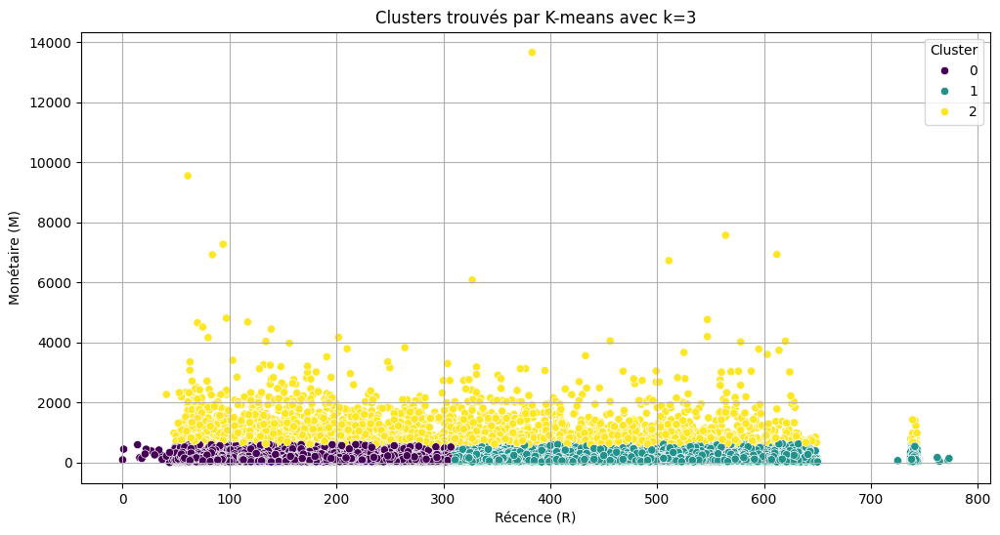

In [1]:
import pandas as pd
from datetime import datetime
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load the data
file_path = 'customer_details_v3.csv'  # Update with your actual file path
customer_data = pd.read_csv(file_path)

# Define the current date for RFM analysis
current_date = datetime.strptime('2018-10-18', '%Y-%m-%d')

# Calculate recency (number of days since the last order)
customer_data['last_order'] = pd.to_datetime(customer_data['last_order'])
customer_data['recency'] = (current_date - customer_data['last_order']).dt.days

# Calculate frequency using the 'connection_days' column
customer_data['frequency'] = customer_data['connection_days']

# Calculate monetary value using the 'total_spent' column
customer_data['monetary'] = customer_data['total_spent']

# Select the necessary columns for RFM analysis
rfm_data = customer_data[['customer_unique_id', 'recency', 'frequency', 'monetary']]

# Ensure the columns are numeric
rfm_data['recency'] = pd.to_numeric(rfm_data['recency'], errors='coerce')
rfm_data['frequency'] = pd.to_numeric(rfm_data['frequency'], errors='coerce')
rfm_data['monetary'] = pd.to_numeric(rfm_data['monetary'], errors='coerce')

# Handle missing values by replacing them with the mean of the column
rfm_data['recency'].fillna(rfm_data['recency'].mean(), inplace=True)
rfm_data['frequency'].fillna(rfm_data['frequency'].mean(), inplace=True)
rfm_data['monetary'].fillna(rfm_data['monetary'].mean(), inplace=True)

# Convert RFM scores to numeric for clustering
rfm_data['R'] = rfm_data['recency'].astype(int)
rfm_data['F'] = rfm_data['frequency'].astype(int)
rfm_data['M'] = rfm_data['monetary'].astype(float)

# Prepare the data for clustering
rfm_features = rfm_data[['R', 'F', 'M']]

# Perform KMeans clustering with k=4
k = 3
kmeans = KMeans(n_clusters=k, random_state=42)
kmeans.fit(rfm_features)

# Add the cluster labels to the RFM data
rfm_data['Cluster'] = kmeans.labels_

# Create a 2D plot of clusters based on R and M
plt.figure(figsize=(12, 6))
sns.scatterplot(x='R', y='M', hue='Cluster', data=rfm_data, palette='viridis')
plt.title('Clusters trouvés par K-means avec k=3')
plt.xlabel('Récence (R)')
plt.ylabel('Monétaire (M)')
plt.grid(True)
plt.show()
